# Lecture : Graph-based Visualization

## Lab 05 : T-Distributed Stochastic Neighbor Embedding (TSNE)

### Xavier Bresson  


In [1]:
# For Google Colaboratory
import sys, os
if 'google.colab' in sys.modules:
    # mount google drive
    from google.colab import drive
    drive.mount('/content/gdrive')
    path_to_file = '/content/gdrive/My Drive/GML2023_codes/codes/06_Visualization'
    print(path_to_file)
    # change current path to the folder containing "path_to_file"
    os.chdir(path_to_file)
    !pwd
    

In [1]:
# Load libraries
import numpy as np
import scipy.io
from matplotlib import pyplot
import matplotlib.pyplot as plt
import time
import sys; sys.path.insert(0, 'lib/')
import scipy.sparse.linalg
# import scipy.ndimage
from lib.utils import construct_knn_graph, nldr_visualization
import warnings; warnings.filterwarnings("ignore")
from sklearn.manifold import TSNE


# LapEigMap for MNIST

In [2]:
# MNIST dataset
mat = scipy.io.loadmat('datasets/MNIST_data.mat')
X = Xnumpy = mat['X']
n = X.shape[0]
d = X.shape[1]
C = mat['C'].squeeze()
print(n,d)


60000 784


Convert from numpy to pytorch
k-NN graph construction with euclidean distance
n, batch_size, num_batch, kNN, device: 60000 2000 30 10 cpu
batch idx: 1 / 30  time(sec): 2.5601699352264404
batch idx: 2 / 30  time(sec): 4.744266033172607
batch idx: 3 / 30  time(sec): 7.347688913345337
batch idx: 4 / 30  time(sec): 9.877192258834839
batch idx: 5 / 30  time(sec): 12.450258255004883
batch idx: 6 / 30  time(sec): 15.0778648853302
batch idx: 7 / 30  time(sec): 17.73613405227661
batch idx: 8 / 30  time(sec): 20.547765016555786
batch idx: 9 / 30  time(sec): 23.814451217651367
batch idx: 10 / 30  time(sec): 26.942660093307495
batch idx: 11 / 30  time(sec): 30.048896074295044
batch idx: 12 / 30  time(sec): 32.835214138031006
batch idx: 13 / 30  time(sec): 35.505321979522705
batch idx: 14 / 30  time(sec): 38.09591603279114
batch idx: 15 / 30  time(sec): 40.855989933013916
batch idx: 16 / 30  time(sec): 43.422643184661865
batch idx: 17 / 30  time(sec): 45.91384220123291
batch idx: 18 / 30  time(sec)

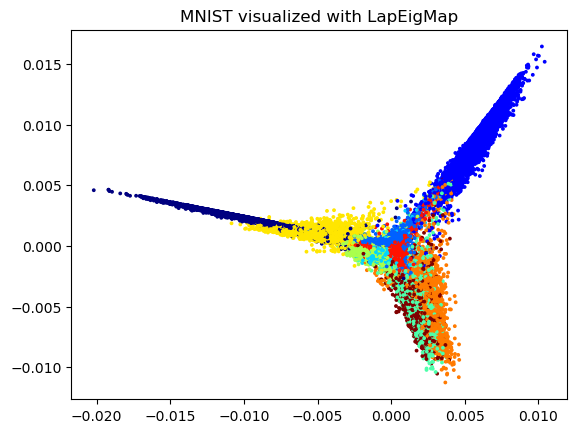

In [3]:
# Compute k-NN graph
kNN = 10
dist = 'euclidean'
W = construct_knn_graph(X, kNN, dist)
#print(W)

# Laplacian Eigenmaps
start = time.time()
Xvis,Yvis,Zvis = nldr_visualization(W)
print('time(sec):',(time.time()-start)/1)

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=3, color=pyplot.jet())
plt.title('MNIST visualized with LapEigMap') 
plt.show()


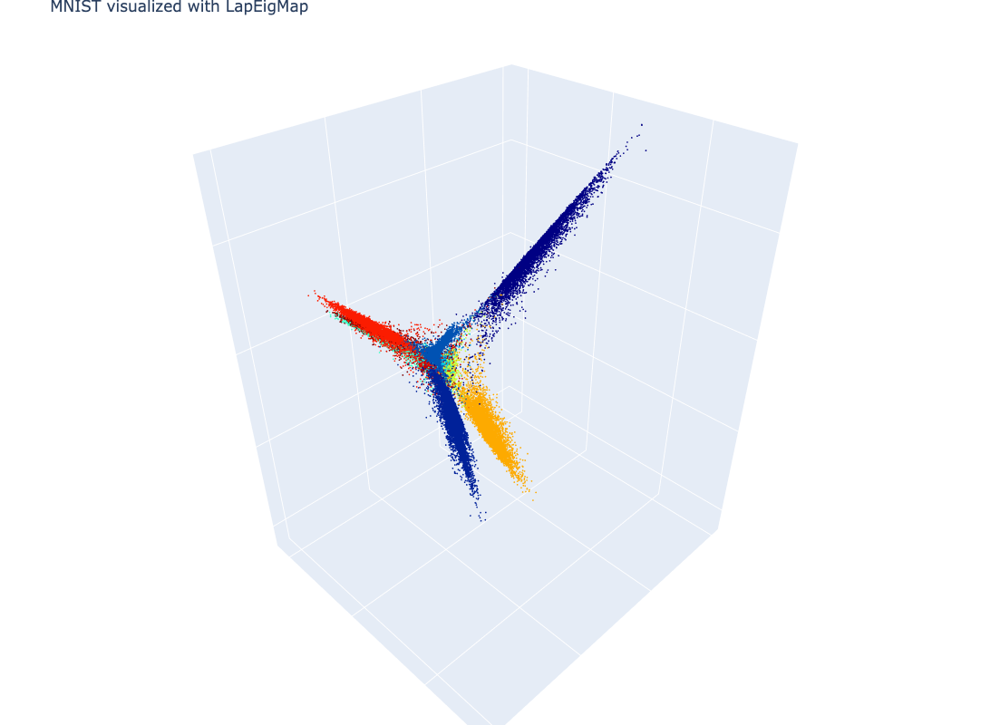

In [4]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="MNIST visualized with LapEigMap") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()


# TSNE for MNIST

(60000, 784)
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 60000 samples in 0.056s...
[t-SNE] Computed neighbors for 60000 samples in 37.697s...
[t-SNE] Computed conditional probabilities for sample 1000 / 60000
[t-SNE] Computed conditional probabilities for sample 2000 / 60000
[t-SNE] Computed conditional probabilities for sample 3000 / 60000
[t-SNE] Computed conditional probabilities for sample 4000 / 60000
[t-SNE] Computed conditional probabilities for sample 5000 / 60000
[t-SNE] Computed conditional probabilities for sample 6000 / 60000
[t-SNE] Computed conditional probabilities for sample 7000 / 60000
[t-SNE] Computed conditional probabilities for sample 8000 / 60000
[t-SNE] Computed conditional probabilities for sample 9000 / 60000
[t-SNE] Computed conditional probabilities for sample 10000 / 60000
[t-SNE] Computed conditional probabilities for sample 11000 / 60000
[t-SNE] Computed conditional probabilities for sample 12000 / 60000
[t-SNE] Computed conditional probab

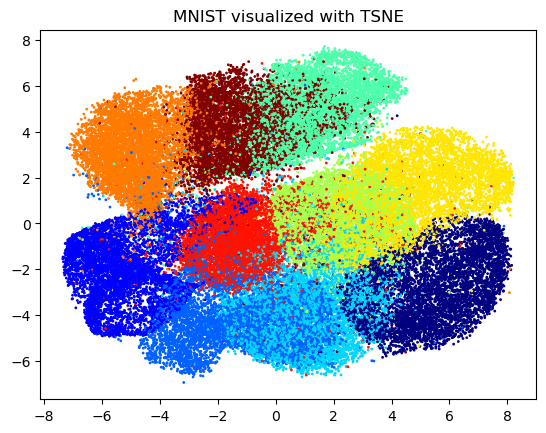

In [5]:
# TSNE
start = time.time()
#tsne = TSNE(n_components=3, learning_rate='auto', init='random', perplexity=3)
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=300)
print(X.shape)
embedding = tsne.fit_transform(X)
print('time(sec):',(time.time()-start)/1)
print(embedding.shape)
Xvis = embedding[:,0]
Yvis = embedding[:,1]
Zvis = embedding[:,2]

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=1, color=pyplot.jet())
plt.title('MNIST visualized with TSNE') 
plt.show()


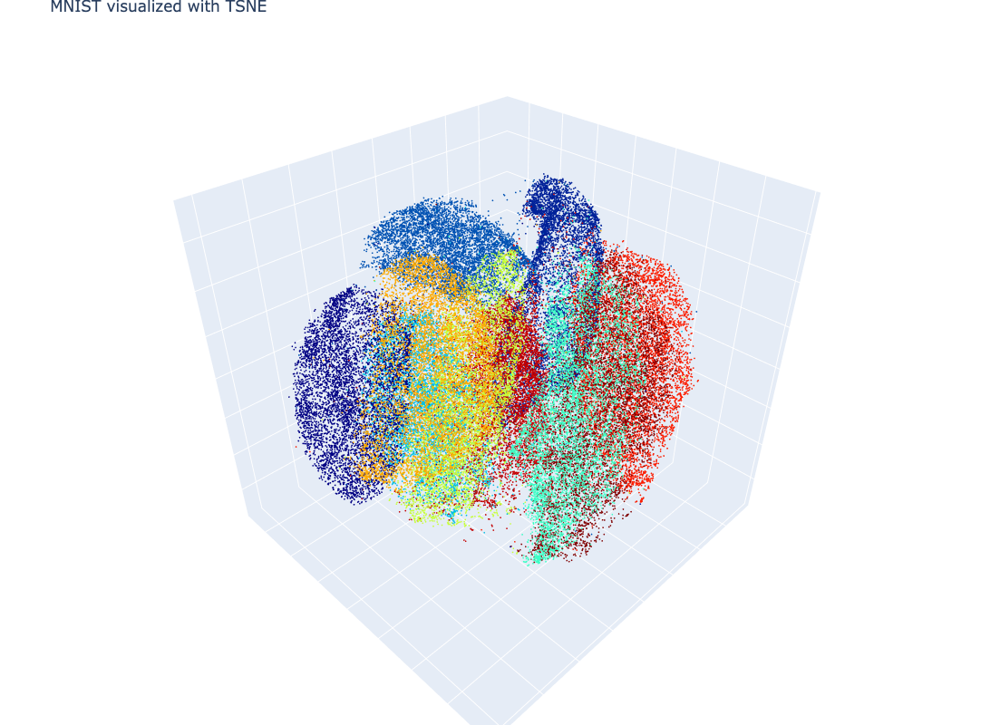

In [6]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="MNIST visualized with TSNE") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()
